# Box Office Revenue Prediction

In [1]:
import numpy as np
import pandas as pd

pd.set_option('display.max_columns', None)
from matplotlib.colors import rgb_to_hsv
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
sns.set(font_scale=1.3)

In [2]:
train_raw = pd.read_csv('data/train.tsv',delimiter='\t')
test_raw = pd.read_csv('data/test.tsv',delimiter='\t')

## Explenatory Data Analysis:

In [3]:
train_raw.head()

,backdrop_path,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,popularity,poster_path,production_companies,production_countries,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count,Keywords,cast,crew
0,/7IBpOrw0ATwL1AOV97mtsceDpYs.jpg,"{'id': 556, 'name': 'Spider-Man Collection', '...",258000000,"[{'id': 14, 'name': 'Fantasy'}, {'id': 28, 'na...",https://www.sonypictures.com/movies/spiderman3,559,tt0413300,en,Spider-Man 3,The seemingly invincible Spider-Man goes up ag...,22.024,/2N9lhZg6VtVJoGCZDjXVC3a81Ea.jpg,"[{'id': 19551, 'logo_path': '/2WpWp9b108hizjHK...","[{'iso_3166_1': 'US', 'name': 'United States o...",2007-05-01,890871626,139.0,"[{'iso_639_1': 'en', 'name': 'English'}, {'iso...",Released,The battle within.,Spider-Man 3,False,6.2,8180,"[{'id': 697, 'name': 'loss of loved one'}, {'i...","[{'cast_id': 30, 'character': 'Peter Parker / ...","[{'credit_id': '52fe4252c3a36847f80151a5', 'de..."
1,/lYeE7k0OR3HXyoq7FeswyaxFJvL.jpg,"{'id': 256296, 'name': 'Silent Night, Deadly N...",250000,"[{'id': 35, 'name': 'Comedy'}, {'id': 27, 'nam...",NaN,50719,tt0093974,en,"Silent Night, Deadly Night Part 2",After being traumatized by his brother Billy's...,4.756,/64ATtm2eMd0yfrTJsHANQ0NmMSn.jpg,"[{'id': 18924, 'logo_path': None, 'name': 'Sil...","[{'iso_3166_1': 'US', 'name': 'United States o...",1987-04-10,154323,88.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,The nightmare is about to begin ... AGAIN!,"Silent Night, Deadly Night Part 2",False,4.3,68,"[{'id': 65, 'name': 'holiday'}, {'id': 1991, '...","[{'cast_id': 1000, 'character': 'Ricky Caldwel...","[{'credit_id': '52fe47d4c3a36847f814a70f', 'de..."
2,/gVXLIfMR2hLmkn0nACctlMCJBfx.jpg,NaN,0,"[{'id': 99, 'name': 'Documentary'}]",https://www.scottymovie.com/,469062,tt2773246,en,Scotty and the Secret History of Hollywood,A deliciously scandalous portrait of unsung Ho...,4.746,/2uXDNXBoIrRBbfpVrvegoLr8OVt.jpg,"[{'id': 88564, 'logo_path': '/pn3p12IC4Tb0K8re...","[{'iso_3166_1': 'US', 'name': 'United States o...",2018-07-27,176236,98.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,NaN,Scotty and the Secret History of Hollywood,False,6.5,15,"[{'id': 158718, 'name': 'lgbt'}]","[{'cast_id': 1, 'character': 'Himself', 'credi...","[{'credit_id': '5980e931c3a3680cfb002d0e', 'de..."
3,/rKjE17ncAGNzeImNWbdGTimzjtk.jpg,"{'id': 8917, 'name': 'Hellraiser Collection', ...",1000000,"[{'id': 27, 'name': 'Horror'}]",NaN,9003,tt0093177,en,Hellraiser,An unfaithful wife encounters the zombie of he...,13.828,/4nfAhOTlfZUHNorHJXEib7GYFpp.jpg,"[{'id': 1950, 'logo_path': None, 'name': 'New ...","[{'iso_3166_1': 'GB', 'name': 'United Kingdom'}]",1987-09-11,14564027,94.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,He'll tear your soul apart.,Hellraiser,False,6.9,1115,"[{'id': 1449, 'name': 'underworld'}, {'id': 31...","[{'cast_id': 15, 'character': 'Larry Cotton', ...","[{'credit_id': '533fd9260e0a262b92001027', 'de..."
4,/zcJxJVhvxNHJJ2J7Q7NhgO9nPUV.jpg,"{'id': 108693, 'name': ""National Lampoon's Vac...",15000000,"[{'id': 35, 'name': 'Comedy'}, {'id': 12, 'nam...",NaN,11153,tt0085995,en,National Lampoon's Vacation,Clark Griswold is on a quest to take his famil...,15.070,/ySI88wO1IFyKGWpSKRTSPilE3t2.jpg,"[{'id': 174, 'logo_path': '/IuAlhI9eVC9Z8UQWOI...","[{'iso_3166_1': 'US', 'name': 'United States o...",1983-07-28,61399552,99.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Every summer Chevy Chase takes his family on a...,National Lampoon's Vacation,False,7.1,782,"[{'id': 5493, 'name': 'relatives'}, {'id': 731...","[{'cast_id': 1, 'character': 'Clark Griswold',...","[{'credit_id': '52fe44039251416c75025f27', 'de..."


In [4]:
test_raw.head()

,backdrop_path,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,popularity,poster_path,production_companies,production_countries,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count,Keywords,cast,crew
0,/nNh7vHHISVAaziJEqAq0P9iL52w.jpg,NaN,58000000,"[{'id': 27, 'name': 'Horror'}, {'id': 878, 'na...",http://www.lifemovie.com/,395992,tt5442430,en,Life,The six-member crew of the International Space...,17.409,/h2mhfbEBGABSHo2vXG1ECMKAJa7.jpg,"[{'id': 5, 'logo_path': '/71BqEFAF4V3qjjMPCpLu...","[{'iso_3166_1': 'US', 'name': 'United States o...",2017-03-22,100541806,103.0,"[{'iso_639_1': 'cn', 'name': '广州话 / 廣州話'}, {'i...",Released,Be careful what you search for,Life,False,6.4,4738,"[{'id': 839, 'name': 'planet mars'}, {'id': 48...","[{'cast_id': 0, 'character': 'Dr. David Jordan...","[{'credit_id': '58bd72b0c3a3686630048e38', 'de..."
1,/7dadBR1sXrl1TTzRQYNGUvQinF4.jpg,NaN,0,"[{'id': 35, 'name': 'Comedy'}, {'id': 80, 'nam...",NaN,20832,tt1182908,hi,क्रैजी 4,A psychiatrist spends the majority of his time...,2.257,/8owptcZPbNIqugAHQOzawgRQM5s.jpg,"[{'id': 64779, 'logo_path': None, 'name': 'Fil...","[{'iso_3166_1': 'IN', 'name': 'India'}]",2008-04-11,8000000,110.0,"[{'iso_639_1': 'hi', 'name': 'हिन्दी'}]",Released,NaN,Krazzy 4,False,4.6,19,[],"[{'cast_id': 4, 'character': 'Raja', 'credit_i...","[{'credit_id': '5cab55c7925141565402137b', 'de..."
2,/ijDUMFmb34Fv7jBwxzhNc3lbVP3.jpg,"{'id': 410261, 'name': 'A Goofy Movie Collecti...",0,"[{'id': 10749, 'name': 'Romance'}, {'id': 16, ...",NaN,15789,tt0113198,en,A Goofy Movie,"Though Goofy always means well, his amiable cl...",13.558,/bycmMhO3iIoEDzP768sUjq2RV4T.jpg,"[{'id': 3475, 'logo_path': '/jTPNzDEn7eHmp3nEX...","[{'iso_3166_1': 'FR', 'name': 'France'}, {'iso...",1995-04-07,35348597,78.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,It’s hard to be cool... when your dad’s Goofy.,A Goofy Movie,False,6.9,964,"[{'id': 970, 'name': 'parent child relationshi...","[{'cast_id': 2, 'character': 'Goofy Goof (voic...","[{'credit_id': '591464b9925141583c00cea9', 'de..."
3,/kb3RNnn4CMPRSaGbrX1ejc7lcRN.jpg,NaN,4000000,"[{'id': 18, 'name': 'Drama'}]",NaN,265180,tt2802154,ru,Левиафан,"In a Russian coastal town, Kolya is forced to ...",7.158,/foMdJ8ijYk5G1Jn0HZRplFTu9Dt.jpg,"[{'id': 5630, 'logo_path': '/s0mHCw53fp6EAapR7...","[{'iso_3166_1': 'RU', 'name': 'Russia'}]",2014-09-24,4396821,141.0,"[{'iso_639_1': 'ru', 'name': 'Pусский'}]",Released,NaN,Leviathan,False,7.5,447,"[{'id': 1415, 'name': 'small town'}, {'id': 19...","[{'cast_id': 3, 'character': 'Nikolay', 'credi...","[{'credit_id': '5b9c25890e0a266e12001f38', 'de..."
4,/wEo4UtBAWdB4aOmQ9wRjI1aS7Dt.jpg,NaN,250000,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",NaN,10098,tt0012349,en,The Kid,A tramp cares for a boy after he's abandoned a...,10.523,/drgMcyTsySQBnUPGaBThCHGdlWT.jpg,"[{'id': 3245, 'logo_path': '/9dBTQp9XitrHkx20i...","[{'iso_3166_1': 'US', 'name': 'United States o...",1921-02-06,2500000,68.0,"[{'iso_639_1': 'xx', 'name': 'No Language'}]",Released,6 reels of Joy.,The Kid,False,8.2,1008,"[{'id': 290, 'name': 'angel'}, {'id': 1252, 'n...","[{'cast_id': 10, 'character': 'A Tramp', 'cred...","[{'credit_id': '52fe43269251416c75005611', 'de..."


We can see that the data contains multiple nested objects (Dictonaries & Lists, represented as strings).

These attributes will be parsed during feature extraction.

Let's see some statistics regarding our data:

In [5]:
train_raw.describe().apply(lambda s: s.apply(lambda x: format(x, 'g')))

,budget,id,popularity,revenue,runtime,vote_average,vote_count
count,5215,5215,5215,5215,5211,5215,5215
mean,2.14797e+07,98768.7,10.0166,6.53874e+07,108.027,6.3991,1062.86
std,3.63151e+07,143993,7.0758,1.43238e+08,22.741,0.943931,2097.17
min,0,5,1.519,1,0,0,0
25%,0,10136,6.264,2.36072e+06,94,5.9,74
50%,6.5e+06,24662,9.009,1.51562e+07,104,6.4,290
75%,2.6e+07,121704,11.801,6.21425e+07,118,7.1,1028
max,3.8e+08,679106,151.237,2.04624e+09,465,10,24834


In [6]:
test_raw.describe().apply(lambda s: s.apply(lambda x: format(x, 'g')))

,budget,id,popularity,revenue,runtime,vote_average,vote_count
count,1738,1738,1738,1738,1736,1738,1738
mean,2.19667e+07,105008,10.0212,6.88059e+07,108.687,6.39614,1027.67
std,3.74423e+07,151577,8.55727,1.61447e+08,22.3713,0.902789,1993.46
min,0,6,1.508,1,0,2,1
25%,0,9944.5,6.37975,2.4047e+06,94,5.8,79
50%,7e+06,23871.5,8.855,1.53426e+07,105,6.4,287
75%,2.575e+07,139091,11.618,6.20512e+07,119,7,914.5
max,3.56e+08,637920,221.327,2.7978e+09,332,10,14471


We can see that both train and test has budget and runtime values of 0.

This is unlikely and thus will be considered as Missing value.

In [7]:
print(f"Amount of movies (train) with 0 budget: {(train_raw.budget == 0).sum()}")
print(f"Amount of movies (train) with 0 runtime: {(train_raw.runtime == 0).sum()}")
print(f"Amount of movies (test) with 0 budget: {(test_raw.budget == 0).sum()}")
print(f"Amount of movies (test) with 0 budget: {(test_raw.runtime == 0).sum()}")

Amount of movies (train) with 0 budget: 1487
Amount of movies (train) with 0 runtime: 12
Amount of movies (test) with 0 budget: 494
Amount of movies (test) with 0 budget: 2


### What is correlated with 'revenue'?

In [8]:
corr_mat = train_raw.corr()
corr_mat.revenue.sort_values(ascending=False)

revenue         1.000000
vote_count      0.769808
budget          0.753590
popularity      0.567924
runtime         0.183223
vote_average    0.159344
id             -0.001979
video          -0.025021
Name: revenue, dtype: float64

Better yet, visualize in a heatmap:

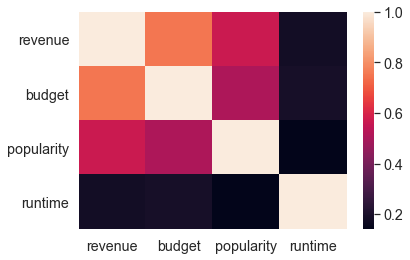

In [9]:
cols =['revenue','budget','popularity','runtime']
sns.heatmap(train_raw[cols].corr())
plt.show()

Let's plot the variables relations:

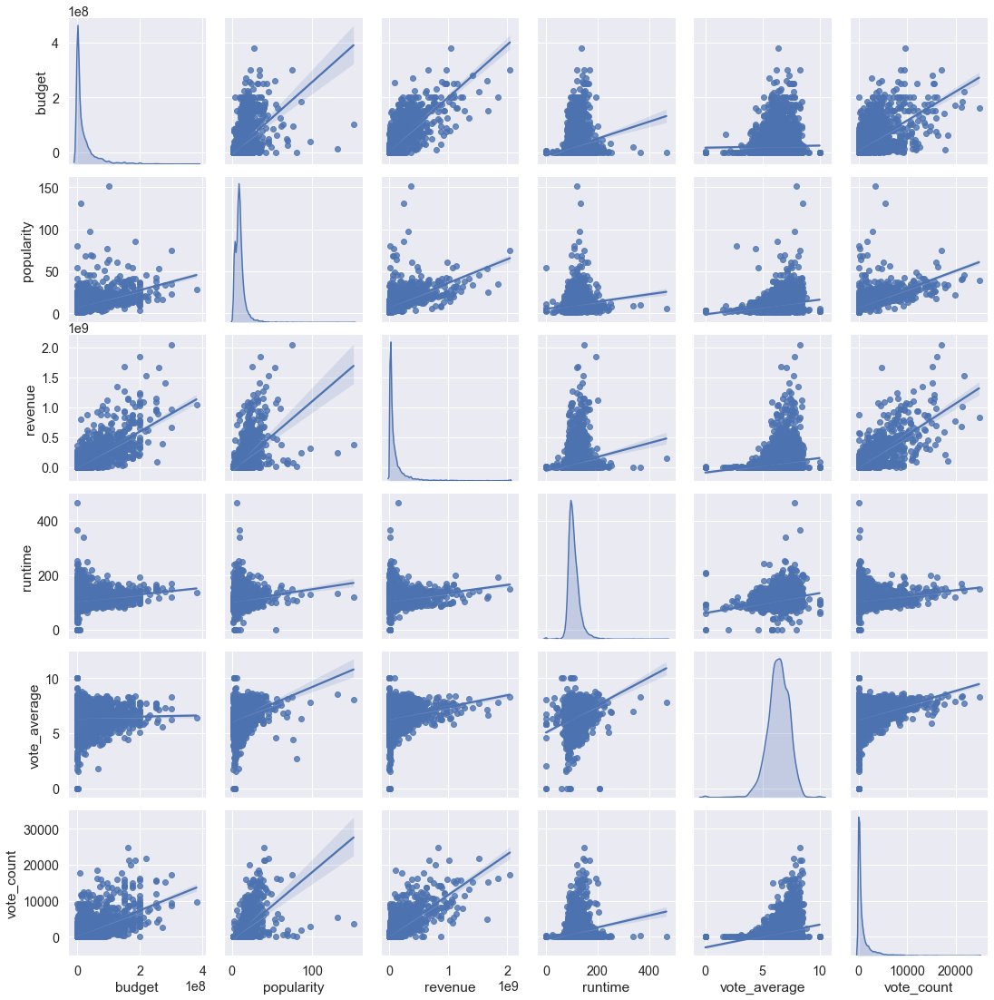

In [10]:
sns.pairplot(train_raw.select_dtypes('number').drop(columns='id'), kind="reg", diag_kind="kde")
plt.show()

### Missing Values:

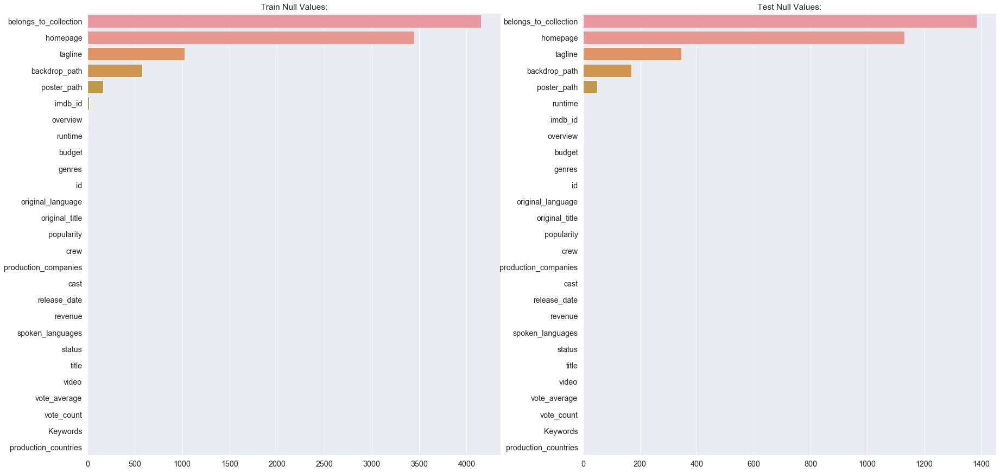

In [11]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(30, 15), sharey=False)

train_na = train_raw.isna().sum().sort_values(ascending=False)
sns.barplot(train_na.values, train_na.index, orient='h', ax=axes[0])
axes[0].set_title('Train Null Values:')

test_na = test_raw.isna().sum().sort_values(ascending=False)
sns.barplot(test_na.values, test_na.index, orient='h', ax=axes[1])
axes[1].set_title('Test Null Values:')

plt.show()

`belongs_to_collection` - many movies aren't part of a collection. ("Logical" Null)
 
`homepage` - Not useful, we can drop it.

`tagline` - about 20% of movies don't have a tagline.

`backdrop_path` & `poster_path` - we will not use any image processing.

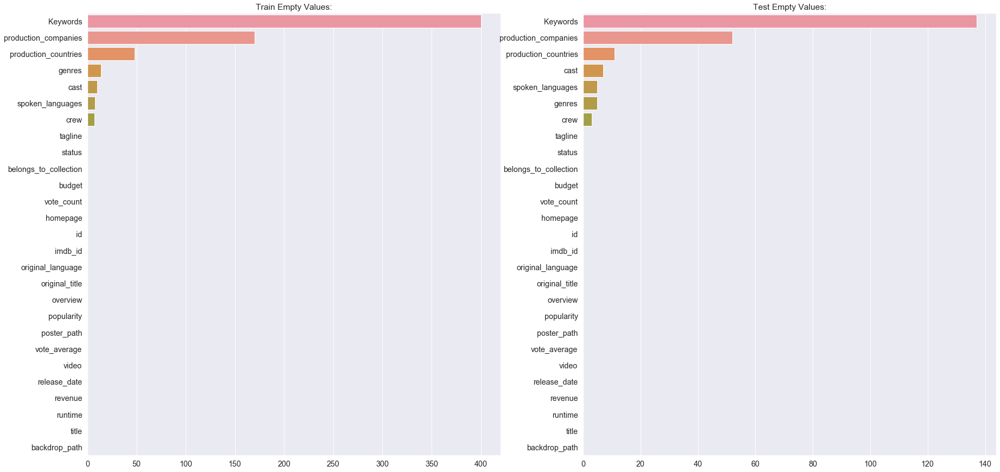

In [12]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(30, 15), sharey=False)

train_na = train_raw.isin(['[]', '{}', '']).sum().sort_values(ascending=False)
sns.barplot(train_na.values, train_na.index, orient='h', ax=axes[0])
axes[0].set_title('Train Empty Values:')

test_na = test_raw.isin(['[]', '{}', '']).sum().sort_values(ascending=False)
sns.barplot(test_na.values, test_na.index, orient='h', ax=axes[1])
axes[1].set_title('Test Empty Values:')

plt.show()

Everything below 10% of the data, and thus ignorable.

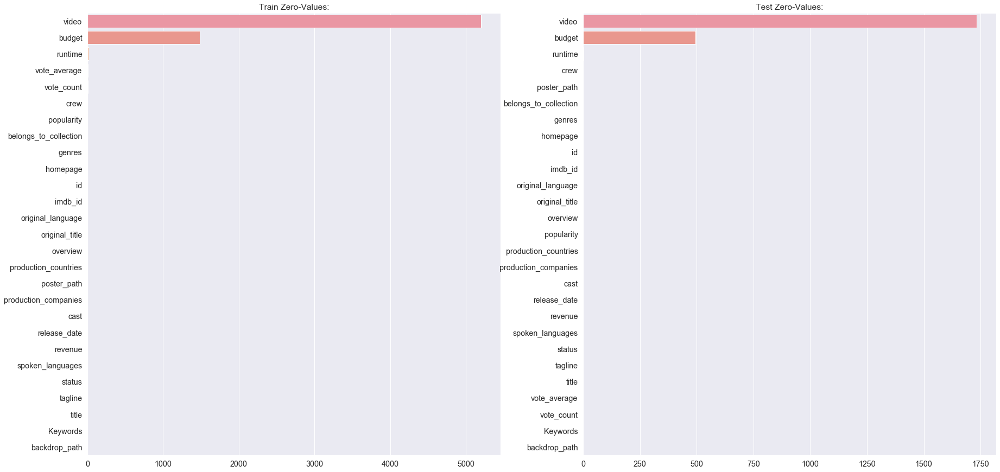

In [13]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(30, 15), sharey=False)

train_na = train_raw.eq(0).sum().sort_values(ascending=False)
sns.barplot(train_na.values, train_na.index, orient='h', ax=axes[0])
axes[0].set_title('Train Zero-Values:')

test_na = test_raw.eq(0).sum().sort_values(ascending=False)
sns.barplot(test_na.values, test_na.index, orient='h', ax=axes[1])
axes[1].set_title('Test Zero-Values:')

plt.show()

`video` - single valued and thus will be ignored.

`budget` & `runtime` - Will be imputated.

## Feature Engineering:

Following our data exploration, we won't use  the following features:

- `backdrop_path` - We won't use any image processing in this task.
- `homepage` - Mostly Nulls.
- `poster_path` - We won't use any image processing in this task.
- `imdb_id` - We won't use IMDb.
- `video` - Single valued, not useful.
- `status` - Mostly single valued (`Released`), not useful.

In [14]:
from feature_engineering import *

train = drop_features(train_raw)
train_X, train_Y = train.drop('revenue', axis=1), train['revenue']
test = drop_features(test_raw)
test_X, test_Y = test.drop('revenue', axis=1), test['revenue']

### Feature Transformations:

First, we should handle with all nested collections attributes.

We used `eval` to convert the string representation of collection to an object.

Then, we've exploded (column-wise) selected attributes from each nested object.

The following attributes were added (mapped):

- `belongs_to_collection.id` : If a movie belongs to a collection, then we keep collection id, else None.
- `genres` : Containing the genre `name` attributes
- `production_comapnies.id` & `production_comapnies.origin_country` : List of production companies id attribute & production companies origin country.
- `production_countries` : List of countries (`iso_3166`) where the movie was filmed.
- `release_month`, `release_quarter`, `release_year` : The month, quarter & year the film was released on.
- `spoken_languages` : List of spoken languages in a movie (`iso_639` attribute).
- `Keywords.id` : List of id attribute for each Keyword.
- `cast.id` & `cast.gender` : List of id & gender (attributes) from `cast` member.
- `crew.id` & `crew.department` : List of id & department (attributes) from `crew` member.


In [15]:
flattened_train = features_flattening(train_X)
flattened_train.head()

,budget,genres,original_language,original_title,overview,popularity,production_countries,runtime,spoken_languages,tagline,title,vote_average,vote_count,belongs_to_collection.id,production_companies.id,production_companies.origin_country,release_month,release_quarter,release_year,Keywords.id,cast.id,cast.gender,crew.id,crew.department
id,,,,,,,,,,,,,,,,,,,,,,,,
559,258000000,"(Fantasy, Action, Adventure)",en,Spider-Man 3,The seemingly invincible Spider-Man goes up ag...,22.024,"(US,)",139.0,"(en, fr)",The battle within.,Spider-Man 3,6.2,8180,556,"(19551, 5, 326, 34)","(US, US, , US)",5,2,2007,"(697, 851, 1453, 1965, 2038, 3446, 3986, 4391,...","(2219, 205, 17051, 19159, 17052, 18997, 18998,...","(2, 1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, ...","(6410, 10570, 7623, 7623, 7624, 7624, 7625, 77...","(Production, Production, Writing, Directing, W..."
50719,250000,"(Comedy, Horror)",en,"Silent Night, Deadly Night Part 2",After being traumatized by his brother Billy's...,4.756,"(US,)",88.0,"(en,)",The nightmare is about to begin ... AGAIN!,"Silent Night, Deadly Night Part 2",4.3,68,256296,"(18924,)","(,)",4,2,1987,"(65, 1991, 9663, 9826, 10714, 11181, 157758, 1...","(151123, 151124, 98078, 560010, 101281, 560011...","(2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, ...","(71031, 91309, 97711, 110718, 213404, 213404, ...","(Sound, Crew, Writing, Camera, Writing, Direct..."
469062,0,"(Documentary,)",en,Scotty and the Secret History of Hollywood,A deliciously scandalous portrait of unsung Ho...,4.746,"(US,)",98.0,"(en,)",NaN,Scotty and the Secret History of Hollywood,6.5,15,<NA>,"(88564,)","(US,)",7,3,2018,"(158718,)","(1862182, 71766, 1862185, 1862186, 11275, 1453...","(2, 2, 0, 0, 2, 2, 1)","(27710, 74761, 143067, 222365, 939501, 1046137...","(Production, Sound, Editing, Sound, Crew, Prod..."
9003,1000000,"(Horror,)",en,Hellraiser,An unfaithful wife encounters the zombie of he...,13.828,"(GB,)",94.0,"(en,)",He'll tear your soul apart.,Hellraiser,6.9,1115,8917,"(1950, 15338, 15339, 15340)","(, , , )",9,3,1987,"(1449, 3182, 6152, 9748, 10327, 10864, 15001, ...","(14782, 45588, 56551, 56552, 24737, 56553, 565...","(2, 1, 1, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, ...","(498, 19155, 19155, 9000, 10121, 10121, 40765,...","(Costume & Make-Up, Sound, Sound, Production, ..."
11153,15000000,"(Comedy, Adventure)",en,National Lampoon's Vacation,Clark Griswold is on a quest to take his famil...,15.070,"(US,)",99.0,"(en,)",Every summer Chevy Chase takes his family on a...,National Lampoon's Vacation,7.1,782,108693,"(174,)","(US,)",7,3,1983,"(5493, 7312, 10673, 14724, 33694, 158340, 179431)","(54812, 821, 70089, 1811, 1904, 1217003, 35109...","(2, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, ...","(1524, 1531, 11505, 14536, 69342, 69343)","(Directing, Editing, Writing, Camera, Producti..."


In [16]:
flattened_test = features_flattening(test_X)
flattened_test.head()

,budget,genres,original_language,original_title,overview,popularity,production_countries,runtime,spoken_languages,tagline,title,vote_average,vote_count,belongs_to_collection.id,production_companies.id,production_companies.origin_country,release_month,release_quarter,release_year,Keywords.id,cast.id,cast.gender,crew.id,crew.department
id,,,,,,,,,,,,,,,,,,,,,,,,
395992,58000000,"(Horror, Science Fiction, Thriller)",en,Life,The six-member crew of the International Space...,17.409,"(US,)",103.0,"(cn, en, ja)",Be careful what you search for,Life,6.4,4738,<NA>,"(5, 82925, 34, 82819)","(US, , US, US)",3,1,2017,"(839, 4862, 9882, 14626, 156039, 160097, 19158...","(131, 933238, 10859, 9195, 1238461, 932267, 13...","(2, 1, 2, 2, 2, 1, 0, 0, 0, 1, 1, 2, 0, 0, 0, 1)","(2210, 3285, 6044, 7932, 9817, 10788, 14765, 1...","(Production, Camera, Production, Writing, Art,..."
20832,0,"(Comedy, Crime, Drama)",hi,क्रैजी 4,A psychiatrist spends the majority of his time...,2.257,"(IN,)",110.0,"(hi,)",NaN,Krazzy 4,4.6,19,<NA>,"(64779,)","(,)",4,2,2008,None,"(85889, 76793, 86011, 35756, 35810, 86031, 856...","(2, 2, 0, 2, 1, 1, 1, 2, 2, 2, 2)","(53616, 85398, 85400, 959445, 1032103, 1032103...","(Sound, Crew, Art, Crew, Production, Writing, ..."
15789,0,"(Romance, Animation, Family, Comedy, Adventure)",en,A Goofy Movie,"Though Goofy always means well, his amiable cl...",13.558,"(FR, US)",78.0,"(en,)",It’s hard to be cool... when your dad’s Goofy.,A Goofy Movie,6.9,964,410261,"(3475, 112779)","(US, FR)",4,2,1995,"(970, 2032, 4344, 6562, 7312, 14809, 157303, 1...","(84213, 61983, 43125, 12077, 93663, 15775, 265...","(2, 2, 2, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 2, ...","(1225, 18382, 15775, 15779, 56147, 60731, 1577...","(Sound, Writing, Directing, Editing, Directing..."
265180,4000000,"(Drama,)",ru,Левиафан,"In a Russian coastal town, Kolya is forced to ...",7.158,"(RU,)",141.0,"(ru,)",NaN,Leviathan,7.5,447,<NA>,"(5630,)","(RU,)",9,3,2014,"(1415, 1919, 3296, 181659, 194176)","(113332, 1067188, 236369, 97368, 393420, 58328...","(2, 1, 0, 2, 1, 0, 2, 2, 2, 0, 1, 0, 2, 2, 2, ...","(1551, 68519, 68519, 68524, 68524, 68525, 1040...","(Sound, Directing, Writing, Sound, Sound, Came..."
10098,250000,"(Comedy, Drama)",en,The Kid,A tramp cares for a boy after he's abandoned a...,10.523,"(US,)",68.0,"(xx,)",6 reels of Joy.,The Kid,8.2,1008,<NA>,"(3245, 1315)","(US, )",2,1,1921,"(290, 1252, 5572, 9253, 14514, 14864, 41005, 1...","(13848, 19426, 21301, 63378, 21306, 63380, 633...","(2, 2, 1, 2, 2, 0, 0, 2, 0, 2, 1, 0, 0, 0, 0, ...","(3945, 13848, 13848, 13848, 13848, 13848, 1402...","(Art, Directing, Editing, Production, Sound, W..."


#### Extract new features:

Now we can try to manipulate the features to extract more information:

- `collection_size` : specify the amount of movies in same collection (within data).
- `biggest_production_company_size` : The size (film count) of production company with most productions, within the production companies of a film.
- `most_companies_country_size` : The size (companies count) of country with most productions companies, within the production companies countries of a film.
- `most_productions_country_size` : The size (film count) of a production county, with most productions, within the production countries of a film.
- `cast.gender_ratio` : The gender ratio (`Males / Females + Males`) of cast.
- `spoken_lang_num` : The amount of spoken languages in a film.
- `overview_word_count` : Amount of words (whitespaces) in overview.
- `tagline_char_count` : The length (characters) of a tagline.
- `title_char_count` : The length (characters) of a title.
- `cast_size` : Amount of cast-members in a film.
- `crew_size` : Amount of crew-members in a film.
- `[Department Name]_depart_size` : The size of department in a film.
- `avg_runtime_by_year` : Mean runtime of films in the released year of a movie.
- `avg_budget_by_year` : Mean budget of films in the released year of a movie.
- `avg_popularity_by_year` : Mean popularity of films in the released year of a movie.
- `title_changed` : Boolean indicating whether the original title is different from title.

In [17]:
extracted_train = feature_extraction(flattened_train)
extracted_train.head()

,budget,genres,original_language,original_title,overview,popularity,production_countries,runtime,spoken_languages,tagline,title,vote_average,vote_count,belongs_to_collection.id,production_companies.id,production_companies.origin_country,release_month,release_quarter,release_year,Keywords.id,cast.id,cast.gender,crew.id,crew.department,collection_size,biggest_production_company_size,most_companies_country_size,most_productions_country_size,cast.gender_ratio,spoken_lang_num,overview_word_count,tagline_char_count,title_char_count,cast_size,crew_size,Art_depart_size,Camera_depart_size,Costume & Make-Up_depart_size,Crew_depart_size,Directing_depart_size,Editing_depart_size,Lighting_depart_size,Production_depart_size,Sound_depart_size,Visual Effects_depart_size,Writing_depart_size,avg_runtime_by_year,avg_budget_by_year,avg_popularity_by_year,title_changed
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
559,258000000,"(Fantasy, Action, Adventure)",en,Spider-Man 3,The seemingly invincible Spider-Man goes up ag...,22.024,"(US,)",139.0,"(en, fr)",The battle within.,Spider-Man 3,6.2,8180,556,"(19551, 5, 326, 34)","(US, US, , US)",5,2,2007,"(697, 851, 1453, 1965, 2038, 3446, 3986, 4391,...","(2219, 205, 17051, 19159, 17052, 18997, 18998,...","(2, 1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, ...","(6410, 10570, 7623, 7623, 7624, 7624, 7625, 77...","(Production, Production, Writing, Directing, W...",2,256,769,3917,0.611111,2,43,18,12,137,57,19,3,2,1,2,1,0,23,1,0,5,106.662651,2.688542e+07,9.319018,False
50719,250000,"(Comedy, Horror)",en,"Silent Night, Deadly Night Part 2",After being traumatized by his brother Billy's...,4.756,"(US,)",88.0,"(en,)",The nightmare is about to begin ... AGAIN!,"Silent Night, Deadly Night Part 2",4.3,68,256296,"(18924,)","(,)",4,2,1987,"(65, 1991, 9663, 9826, 10714, 11181, 157758, 1...","(151123, 151124, 98078, 560010, 101281, 560011...","(2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, ...","(71031, 91309, 97711, 110718, 213404, 213404, ...","(Sound, Crew, Writing, Camera, Writing, Direct...",1,1,0,3917,0.416667,1,48,42,33,52,15,0,1,0,2,1,1,0,1,1,0,8,103.486486,6.727433e+06,8.119851,False
469062,0,"(Documentary,)",en,Scotty and the Secret History of Hollywood,A deliciously scandalous portrait of unsung Ho...,4.746,"(US,)",98.0,"(en,)",NaN,Scotty and the Secret History of Hollywood,6.5,15,<NA>,"(88564,)","(US,)",7,3,2018,"(158718,)","(1862182, 71766, 1862185, 1862186, 11275, 1453...","(2, 2, 0, 0, 2, 2, 1)","(27710, 74761, 143067, 222365, 939501, 1046137...","(Production, Sound, Editing, Sound, Crew, Prod...",0,1,769,3917,0.200000,1,23,0,42,7,57,1,6,0,4,1,16,0,20,9,0,0,109.064286,2.937105e+07,14.132214,False
9003,1000000,"(Horror,)",en,Hellraiser,An unfaithful wife encounters the zombie of he...,13.828,"(GB,)",94.0,"(en,)",He'll tear your soul apart.,Hellraiser,6.9,1115,8917,"(1950, 15338, 15339, 15340)","(, , , )",9,3,1987,"(1449, 3182, 6152, 9748, 10327, 10864, 15001, ...","(14782, 45588, 56551, 56552, 24737, 56553, 565...","(2, 1, 1, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, ...","(498, 19155, 19155, 9000, 10121, 10121, 40765,...","(Costume & Make-Up, Sound, Sound, Production, ...",2,10,0,671,0.230769,1,23,27,10,22,71,5,4,7,20,6,3,3,9,8,4,2,103.486486,6.727433e+06,8.119851,False
11153,15000000,"(Comedy, Adventure)",en,National Lampoon's Vacation,Clark Griswold is on a quest to take his famil...,15.070,"(US,)",99.0,"(en,)",Every summer Chevy Chase takes his family on a...,National Lampoon's Vacation,7.1,782,108693,"(174,)","(US,)",7,3,1983,"(5493, 7312, 10673, 14724, 33694, 158340, 179431)","(54812, 821, 70089, 1811, 1904, 1217003, 35109...","(2, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, ...","(1524, 1531, 11505, 14536, 69342, 69343)","(Directing, Editing, Writing, Camera, Producti...",2,344,769,3917,0.272727,1,28,86,27,24,6,0,1,0,0,1,1,0,1,1,0,1,101.666667,6.459246e+06,7.817860,False


In [18]:
extracted_test = feature_extraction(flattened_test)
extracted_test.head()

,budget,genres,original_language,original_title,overview,popularity,production_countries,runtime,spoken_languages,tagline,title,vote_average,vote_count,belongs_to_collection.id,production_companies.id,production_companies.origin_country,release_month,release_quarter,release_year,Keywords.id,cast.id,cast.gender,crew.id,crew.department,collection_size,biggest_production_company_size,most_companies_country_size,most_productions_country_size,cast.gender_ratio,spoken_lang_num,overview_word_count,tagline_char_count,title_char_count,cast_size,crew_size,Art_depart_size,Camera_depart_size,Costume & Make-Up_depart_size,Crew_depart_size,Directing_depart_size,Editing_depart_size,Lighting_depart_size,Production_depart_size,Sound_depart_size,Visual Effects_depart_size,Writing_depart_size,avg_runtime_by_year,avg_budget_by_year,avg_popularity_by_year,title_changed
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
395992,58000000,"(Horror, Science Fiction, Thriller)",en,Life,The six-member crew of the International Space...,17.409,"(US,)",103.0,"(cn, en, ja)",Be careful what you search for,Life,6.4,4738,<NA>,"(5, 82925, 34, 82819)","(US, , US, US)",3,1,2017,"(839, 4862, 9882, 14626, 156039, 160097, 19158...","(131, 933238, 10859, 9195, 1238461, 932267, 13...","(2, 1, 2, 2, 2, 1, 0, 0, 0, 1, 1, 2, 0, 0, 0, 1)","(2210, 3285, 6044, 7932, 9817, 10788, 14765, 1...","(Production, Camera, Production, Writing, Art,...",0,86,495,1293,0.500000,3,32,30,4,16,82,11,6,7,8,5,3,0,10,11,19,2,111.184615,2.342561e+07,11.716723,False
20832,0,"(Comedy, Crime, Drama)",hi,क्रैजी 4,A psychiatrist spends the majority of his time...,2.257,"(IN,)",110.0,"(hi,)",NaN,Krazzy 4,4.6,19,<NA>,"(64779,)","(,)",4,2,2008,None,"(85889, 76793, 86011, 35756, 35810, 86031, 856...","(2, 2, 0, 2, 1, 1, 1, 2, 2, 2, 2)","(53616, 85398, 85400, 959445, 1032103, 1032103...","(Sound, Crew, Art, Crew, Production, Writing, ...",0,1,0,66,0.300000,1,28,0,8,11,15,1,1,1,2,1,1,0,4,2,0,2,106.544118,2.582474e+07,9.763456,True
15789,0,"(Romance, Animation, Family, Comedy, Adventure)",en,A Goofy Movie,"Though Goofy always means well, his amiable cl...",13.558,"(FR, US)",78.0,"(en,)",It’s hard to be cool... when your dad’s Goofy.,A Goofy Movie,6.9,964,410261,"(3475, 112779)","(US, FR)",4,2,1995,"(970, 2032, 4344, 6562, 7312, 14809, 157303, 1...","(84213, 61983, 43125, 12077, 93663, 15775, 265...","(2, 2, 2, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 2, ...","(1225, 18382, 15775, 15779, 56147, 60731, 1577...","(Sound, Writing, Directing, Editing, Directing...",1,2,495,1293,0.235294,1,84,46,13,17,23,1,0,0,2,2,1,0,3,8,2,4,112.129032,2.744901e+07,10.640065,False
265180,4000000,"(Drama,)",ru,Левиафан,"In a Russian coastal town, Kolya is forced to ...",7.158,"(RU,)",141.0,"(ru,)",NaN,Leviathan,7.5,447,<NA>,"(5630,)","(RU,)",9,3,2014,"(1415, 1919, 3296, 181659, 194176)","(113332, 1067188, 236369, 97368, 393420, 58328...","(2, 1, 0, 2, 1, 0, 2, 2, 2, 0, 1, 0, 2, 2, 2, ...","(1551, 68519, 68519, 68524, 68524, 68525, 1040...","(Sound, Directing, Writing, Sound, Sound, Came...",0,2,16,30,0.352941,1,42,0,9,21,30,3,3,2,2,1,1,3,6,5,2,2,107.153846,1.739839e+07,9.930731,True
10098,250000,"(Comedy, Drama)",en,The Kid,A tramp cares for a boy after he's abandoned a...,10.523,"(US,)",68.0,"(xx,)",6 reels of Joy.,The Kid,8.2,1008,<NA>,"(3245, 1315)","(US, )",2,1,1921,"(290, 1252, 5572, 9253, 14514, 14864, 41005, 1...","(13848, 19426, 21301, 63378, 21306, 63380, 633...","(2, 2, 1, 2, 2, 0, 0, 2, 0, 2, 1, 0, 0, 0, 0, ...","(3945, 13848, 13848, 13848, 13848, 13848, 1402...","(Art, Directing, Editing, Production, Sound, W...",0,1,495,1293,0.357143,1,31,15,7,35,12,1,2,0,2,3,1,0,1,1,0,1,68.000000,2.500000e+05,10.523000,False


#### Dummy variables, Dummy variables everywhere

Our data contain **many** categorical features, we need to convert them to dummy variables before any learning can be preformed.

- **Keywords** : Since there are roughly `10,000` unique keywords in train data, we will use only the top 20 most-frequent keywords in train. This will provide high confidence that these keywords will be meaningful in validation\test data.
- **Genres** : We will use all genres (19), as dummy variables.
- **Production Companies** : Since there are **many** production companies (over `70,000`), we will be create a dummy variable from the top 10 most-frequent production companies in train data.
- **Production Countries** : We will use the top 10 most-frequent production countries in train data.
- **Spoken Languages** : We will use the top 10 most-frequent spoken languages in train data.
- **Original Language** : We will use the top 10 most-frequent original language in train data.

All these dummy variables will be extracted from train data, and be hard coded to use in test preprocessing.

In [19]:
dummy_train = add_dummies_train(extracted_train)
print(f"Added {dummy_train.shape[1] - extracted_train.shape[1]} dummy variables to train!")

Added 79 dummy variables to train!


In [20]:
dummy_test = add_dummies_test(extracted_test)
print(f"Added {dummy_test.shape[1] - extracted_test.shape[1]} dummy variables to test!")

Added 79 dummy variables to test!


#### Ehh, Some cleaning:

In [21]:
# Drop unneccesry fields:
tuple_fields = ['genres', 'spoken_languages', 'production_countries', 'production_companies.id', 'Keywords.id', 'cast.id', 'cast.gender', 'crew.id', 'crew.department', 'belongs_to_collection.id', 'production_companies.origin_country']
text_fields = ['original_language', 'original_title', 'overview', 'tagline', 'title']

dummy_train.drop(tuple_fields + text_fields, axis=1, inplace=True)
dummy_test.drop(tuple_fields + text_fields, axis=1, inplace=True)

#### Missing values Imputation:

We will use KNN (`k = 5, Euclidean distance`) Imputation to find budget & runtime for films with zero values.

In [22]:
imputated_train =  missing_value_imputation(dummy_train)
imputated_test =  missing_value_imputation(dummy_test)

#### Scale budget to logarithmic scale:

In [23]:
imputated_train['budget'] = imputated_train.budget.transform(np.log1p)
imputated_test['budget'] = imputated_test.budget.transform(np.log1p)

### Preprocessing results:

In [24]:
imputated_train

,budget,popularity,runtime,vote_average,vote_count,release_month,release_quarter,release_year,collection_size,biggest_production_company_size,most_companies_country_size,most_productions_country_size,cast.gender_ratio,spoken_lang_num,overview_word_count,tagline_char_count,title_char_count,cast_size,crew_size,Art_depart_size,Camera_depart_size,Costume & Make-Up_depart_size,Crew_depart_size,Directing_depart_size,Editing_depart_size,Lighting_depart_size,Production_depart_size,Sound_depart_size,Visual Effects_depart_size,Writing_depart_size,avg_runtime_by_year,avg_budget_by_year,avg_popularity_by_year,title_changed,keyword_818,keyword_187056,keyword_9826,keyword_179431,keyword_242,keyword_14819,keyword_5565,keyword_9672,keyword_9663,keyword_10183,keyword_9748,keyword_6054,keyword_9673,keyword_970,keyword_6149,keyword_6075,keyword_380,keyword_4565,keyword_13130,keyword_179430,genre_Action,genre_Adventure,genre_Animation,genre_Comedy,genre_Crime,genre_Documentary,genre_Drama,genre_Family,genre_Fantasy,genre_History,genre_Horror,genre_Music,genre_Mystery,genre_Romance,genre_Science Fiction,genre_TV Movie,genre_Thriller,genre_War,genre_Western,company_174,company_33,company_4,company_5,company_25,company_21,company_12,company_104,company_9195,company_2,country_US,country_GB,country_FR,country_DE,country_CA,country_IN,country_JP,country_IT,country_ES,country_AU,spoken_lang_en,spoken_lang_fr,spoken_lang_es,spoken_lang_de,spoken_lang_it,spoken_lang_ru,spoken_lang_ja,spoken_lang_hi,spoken_lang_zh,spoken_lang_ar,original_lang_en,original_lang_fr,original_lang_hi,original_lang_ja,original_lang_es,original_lang_ru,original_lang_ko,original_lang_it,original_lang_zh,original_lang_cn
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
559,19.368470,22.024,139.0,6.2,8180.0,5.0,2.0,2007.0,2.0,256.0,769.0,3917.0,0.611111,2.0,43.0,18.0,12.0,137.0,57.0,19.0,3.0,2.0,1.0,2.0,1.0,0.0,23.0,1.0,0.0,5.0,106.662651,2.688542e+07,9.319018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50719,12.429220,4.756,88.0,4.3,68.0,4.0,2.0,1987.0,1.0,1.0,0.0,3917.0,0.416667,1.0,48.0,42.0,33.0,52.0,15.0,0.0,1.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,8.0,103.486486,6.727433e+06,8.119851,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
469062,14.923418,4.746,98.0,6.5,15.0,7.0,3.0,2018.0,0.0,1.0,769.0,3917.0,0.200000,1.0,23.0,0.0,42.0,7.0,57.0,1.0,6.0,0.0,4.0,1.0,16.0,0.0,20.0,9.0,0.0,0.0,109.064286,2.937105e+07,14.132214,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9003,13.815512,13.828,94.0,6.9,1115.0,9.0,3.0,1987.0,2.0,10.0,0.0,671.0,0.230769,1.0,23.0,27.0,10.0,22.0,71.0,5.0,4.0,7.0,20.0,6.0,3.0,3.0,9.0,8.0,4.0,2.0,103.486486,6.727433e+06,8.119851,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11153,16.523561,15.070,99.0,7.1,782.0,7.0,3.0,1983.0,2.0,344.0,769.0,3917.0,0.272727,1.0,28.0,86.0,27.0,24.0,6.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,

In [25]:
imputated_test

,budget,popularity,runtime,vote_average,vote_count,release_month,release_quarter,release_year,collection_size,biggest_production_company_size,most_companies_country_size,most_productions_country_size,cast.gender_ratio,spoken_lang_num,overview_word_count,tagline_char_count,title_char_count,cast_size,crew_size,Art_depart_size,Camera_depart_size,Costume & Make-Up_depart_size,Crew_depart_size,Directing_depart_size,Editing_depart_size,Lighting_depart_size,Production_depart_size,Sound_depart_size,Visual Effects_depart_size,Writing_depart_size,avg_runtime_by_year,avg_budget_by_year,avg_popularity_by_year,title_changed,keyword_818,keyword_187056,keyword_9826,keyword_179431,keyword_242,keyword_14819,keyword_5565,keyword_9672,keyword_9663,keyword_10183,keyword_9748,keyword_6054,keyword_9673,keyword_970,keyword_6149,keyword_6075,keyword_380,keyword_4565,keyword_13130,keyword_179430,genre_Action,genre_Adventure,genre_Animation,genre_Comedy,genre_Crime,genre_Documentary,genre_Drama,genre_Family,genre_Fantasy,genre_History,genre_Horror,genre_Music,genre_Mystery,genre_Romance,genre_Science Fiction,genre_TV Movie,genre_Thriller,genre_War,genre_Western,company_174,company_33,company_4,company_5,company_25,company_21,company_12,company_104,company_9195,company_2,country_US,country_GB,country_FR,country_DE,country_CA,country_IN,country_JP,country_IT,country_ES,country_AU,spoken_lang_en,spoken_lang_fr,spoken_lang_es,spoken_lang_de,spoken_lang_it,spoken_lang_ru,spoken_lang_ja,spoken_lang_hi,spoken_lang_zh,spoken_lang_ar,original_lang_en,original_lang_fr,original_lang_hi,original_lang_ja,original_lang_es,original_lang_ru,original_lang_ko,original_lang_it,original_lang_zh,original_lang_cn
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
395992,17.875954,17.409,103.0,6.4,4738.0,3.0,1.0,2017.0,0.0,86.0,495.0,1293.0,0.500000,3.0,32.0,30.0,4.0,16.0,82.0,11.0,6.0,7.0,8.0,5.0,3.0,0.0,10.0,11.0,19.0,2.0,111.184615,2.342561e+07,11.716723,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20832,16.397405,2.257,110.0,4.6,19.0,4.0,2.0,2008.0,0.0,1.0,0.0,66.0,0.300000,1.0,28.0,0.0,8.0,11.0,15.0,1.0,1.0,1.0,2.0,1.0,1.0,0.0,4.0,2.0,0.0,2.0,106.544118,2.582474e+07,9.763456,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15789,17.130424,13.558,78.0,6.9,964.0,4.0,2.0,1995.0,1.0,2.0,495.0,1293.0,0.235294,1.0,84.0,46.0,13.0,17.0,23.0,1.0,0.0,0.0,2.0,2.0,1.0,0.0,3.0,8.0,2.0,4.0,112.129032,2.744901e+07,10.640065,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
265180,15.201805,7.158,141.0,7.5,447.0,9.0,3.0,2014.0,0.0,2.0,16.0,30.0,0.352941,1.0,42.0,0.0,9.0,21.0,30.0,3.0,3.0,2.0,2.0,1.0,1.0,3.0,6.0,5.0,2.0,2.0,107.153846,1.739839e+07,9.930731,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
10098,12.429220,10.523,68.0,8.2,1008.0,2.0,1.0,1921.0,0.0,1.0,495.0,1293.0,0.357143,1.0,31.0,15.0,7.0,35.0,12.0,1.0,2.0,0.0,2.0,3.0,1.0,0.0,1.0,1.0,0.0,1.0

## Prediction:

We tried multiple models, while focusing on ensemble methods due to the amount of features.

Then, we used CV for hyperparameters tuning for two selected models:

* Random Forest
  * number of estimators: One of `100, 200, 500, 1000, 1500, 2000`.
  * criterion: `mean sqaured error` or `mean absolute error`.
  * maximum features: One of: `N, Sqaure-root(N), log2(N), 0.2 * N, 0.4 * N, 0.6 * N, 0.8 * N`
  * maximum depth: One of `10, 20, 30, ..., 200`.
  * minimum samples split: One of `2, 5, 10 ,20`.
  * minimum samples in leaf: One of `1, 2, 4, 8, 16`.
  * bootstrap: `True` or `False`.

* XGBoost
  * number of estimators: One of `100, 200, 500, 1000, 1500`.
  * objective function: `Linear` or `Squared Error`.
  * learning rate: One of `0.01, 0.03, 0.05, .07`.
  * maximum depth: One of `4, 5, 6, 7, 8, 9, 10, 20`.
  * gamma (Min. loss reduction threshold): One of `0, 0.3, 0.4, 0.5, 1, 5`.
  * minimum child weight: One of `1, 4, 5`.
  * lambda (L2 regularization coef.): One of `0, 1, 5, 10`.
  * alpha (L1 regularization coef.): One of `0, 1, 2`.

Finally, the following models were chosen:

In [26]:
from sklearn.metrics import mean_squared_log_error

def train_model(train_X, train_Y, model):
    model.fit(train_X, np.log1p(train_Y))

    with open(f"models/{model.__class__.__name__}.pkl", 'wb') as f:
        pickle.dump(model, f)

def evaluate_model(test_X, test_Y, model):
    pred = np.expm1(model.predict(test_X))

    rmsle = np.sqrt(mean_squared_log_error(test_Y, pred))
    print(f"RMSLE for Test: {rmsle:.6f}")

In [29]:
# XGBoost Model:
import xgboost as xgb

xg_params = {   'subsample': 0.6, 
                'reg_lambda': 10, 
                'reg_alpha': 2, 
                'objective': 'reg:squarederror', 
                'n_estimators': 1000, 
                'min_child_weight': 4, 
                'max_depth': 7, 
                'learning_rate': 0.01, 
                'gamma': 0.5, 
                'colsample_bytree': 0.6 }

xgb_model = xgb.XGBRegressor(**xg_params, n_jobs= -1)
train_model(imputated_train, train_Y, xgb_model)
evaluate_model(imputated_test, test_Y, xgb_model)

RMSLE for Test: 1.786701


In [31]:
# Random Forest Model:
from sklearn.ensemble import RandomForestRegressor

rf_params = {   'n_estimators': 1500,
                'min_samples_split': 2,
                'min_samples_leaf': 2,
                'max_features': 0.4,
                'max_depth': 50,
                'criterion': 'mae',
                'bootstrap': False  }

rf_model = RandomForestRegressor(**rf_params, n_jobs= -1)
train_model(imputated_train, train_Y, rf_model)
evaluate_model(imputated_test, test_Y, rf_model)

RMSLE for Test: 1.831224
